In [2]:
#Import the libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns 
from sklearn import metrics
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report
import os





In [3]:
#load the data
os.chdir("D:\\ACMEGRADE\\ALL NOTES\\Jan 24 DS Day20 Project-20240612T151327Z-001\\Jan 24 DS Day20 Project\\Detection of Parkinsons Disease\\")


In [4]:
print (os.getcwd())

D:\ACMEGRADE\ALL NOTES\Jan 24 DS Day20 Project-20240612T151327Z-001\Jan 24 DS Day20 Project\Detection of Parkinsons Disease


In [5]:
#read the data
df= pd.read_csv('parkinsons.data')
display(df)

,name,MDVP:Fo(Hz),MDVP:Fhi(Hz),MDVP:Flo(Hz),MDVP:Jitter(%),MDVP:Jitter(Abs),MDVP:RAP,MDVP:PPQ,Jitter:DDP,MDVP:Shimmer,...,Shimmer:DDA,NHR,HNR,status,RPDE,DFA,spread1,spread2,D2,PPE
0,phon_R01_S01_1,119.992,157.302,74.997,0.00784,0.00007,0.00370,0.00554,0.01109,0.04374,...,0.06545,0.02211,21.033,1,0.414783,0.815285,-4.813031,0.266482,2.301442,0.284654
1,phon_R01_S01_2,122.400,148.650,113.819,0.00968,0.00008,0.00465,0.00696,0.01394,0.06134,...,0.09403,0.01929,19.085,1,0.458359,0.819521,-4.075192,0.335590,2.486855,0.368674
2,phon_R01_S01_3,116.682,131.111,111.555,0.01050,0.00009,0.00544,0.00781,0.01633,0.05233,...,0.08270,0.01309,20.651,1,0.429895,0.825288,-4.443179,0.311173,2.342259,0.332634
3,phon_R01_S01_4,116.676,137.871,111.366,0.00997,0.00009,0.00502,0.00698,0.01505,0.05492,...,0.08771,0.01353,20.644,1,0.434969,0.819235,-4.117501,0.334147,2.405554,0.368975
4,phon_R01_S01_5,116.014,141.781,110.655,0.01284,0.00011,0.00655,0.00908,0.01966,0.06425,...,0.10470,0.01767,19.649,1,0.417356,0.823484,-3.747787,0.234513,2.332180,0.410335
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
190,phon_R01_S50_2,174.188,230.978,94.261,0.00459,0.00003,0.00263,0.00259,0.00790,0.04087,...,0.07008,0.02764,19.517,0,0.448439,0.657899,-6.538586,0.121952,2.657476,0.133050
191,phon_R01_S50_3,209.516,253.017,89.488,0.00564,0.00003,0.00331,0.00292,0.00994,0.02751,...,0.04812,0.01810,19.147,0,0.431674,0.683244,-6.195325,0.129303,2.784312,0.168895
192,phon_R01_S50_4,174.688,240.005,74.287,0.01360,0.00008,0.00624,0.00564,0.01873,0.02308,...,0.03804,0.10715,17.883,0,0.407567,0.655683,-6.787197,0.158453,2.679772,0.131728
193,phon_R01_S50_5,198.764,396.961,74.904,0.00740,0.00004,0.00370,0.00390,0.01109,0.02296,...,0.03794,0.07223,19.020,0,0.451221,0.643956,-6.744577,0.207454,2.138608,0.123306


In [6]:
#pandas profiling (EDA)
import ydata_profiling as pf
display(pf.ProfileReport(df))

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [7]:
#explore the data (Manual EDA)
display(df.shape)

(195, 24)

In [8]:
display(df.dtypes)

name                 object
MDVP:Fo(Hz)         float64
MDVP:Fhi(Hz)        float64
MDVP:Flo(Hz)        float64
MDVP:Jitter(%)      float64
MDVP:Jitter(Abs)    float64
MDVP:RAP            float64
MDVP:PPQ            float64
Jitter:DDP          float64
MDVP:Shimmer        float64
MDVP:Shimmer(dB)    float64
Shimmer:APQ3        float64
Shimmer:APQ5        float64
MDVP:APQ            float64
Shimmer:DDA         float64
NHR                 float64
HNR                 float64
status                int64
RPDE                float64
DFA                 float64
spread1             float64
spread2             float64
D2                  float64
PPE                 float64
dtype: object

In [9]:
display(df.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 195 entries, 0 to 194
Data columns (total 24 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   name              195 non-null    object 
 1   MDVP:Fo(Hz)       195 non-null    float64
 2   MDVP:Fhi(Hz)      195 non-null    float64
 3   MDVP:Flo(Hz)      195 non-null    float64
 4   MDVP:Jitter(%)    195 non-null    float64
 5   MDVP:Jitter(Abs)  195 non-null    float64
 6   MDVP:RAP          195 non-null    float64
 7   MDVP:PPQ          195 non-null    float64
 8   Jitter:DDP        195 non-null    float64
 9   MDVP:Shimmer      195 non-null    float64
 10  MDVP:Shimmer(dB)  195 non-null    float64
 11  Shimmer:APQ3      195 non-null    float64
 12  Shimmer:APQ5      195 non-null    float64
 13  MDVP:APQ          195 non-null    float64
 14  Shimmer:DDA       195 non-null    float64
 15  NHR               195 non-null    float64
 16  HNR               195 non-null    float64
 1

None

In [10]:
print(df.columns)

Index(['name', 'MDVP:Fo(Hz)', 'MDVP:Fhi(Hz)', 'MDVP:Flo(Hz)', 'MDVP:Jitter(%)',
       'MDVP:Jitter(Abs)', 'MDVP:RAP', 'MDVP:PPQ', 'Jitter:DDP',
       'MDVP:Shimmer', 'MDVP:Shimmer(dB)', 'Shimmer:APQ3', 'Shimmer:APQ5',
       'MDVP:APQ', 'Shimmer:DDA', 'NHR', 'HNR', 'status', 'RPDE', 'DFA',
       'spread1', 'spread2', 'D2', 'PPE'],
      dtype='object')


In [11]:
#display the dependent variable ie "y"
display(df['status'])

0      1
1      1
2      1
3      1
4      1
      ..
190    0
191    0
192    0
193    0
194    0
Name: status, Length: 195, dtype: int64

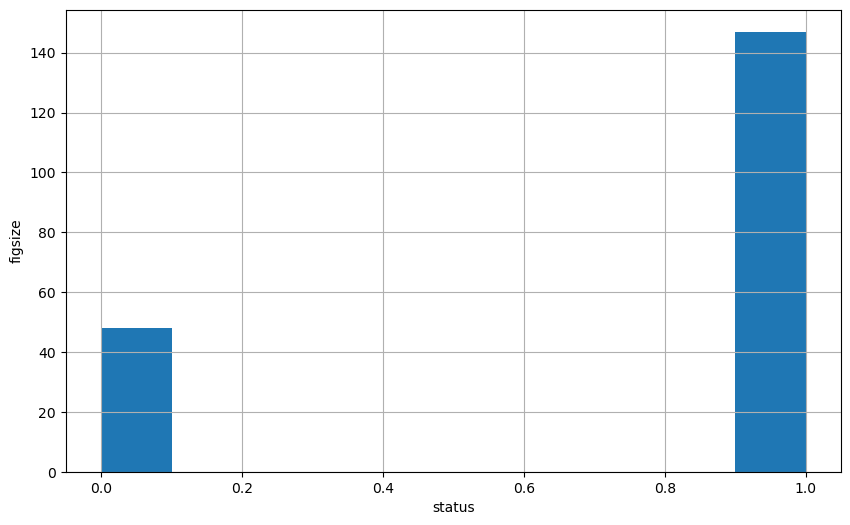

In [12]:
#to check how many records are there in each category i.e 0 and 1
plt.figure(figsize=(10,6))
df.status.hist()
plt.xlabel('status')
plt.ylabel('figsize')
plt.plot()
plt.show()
           

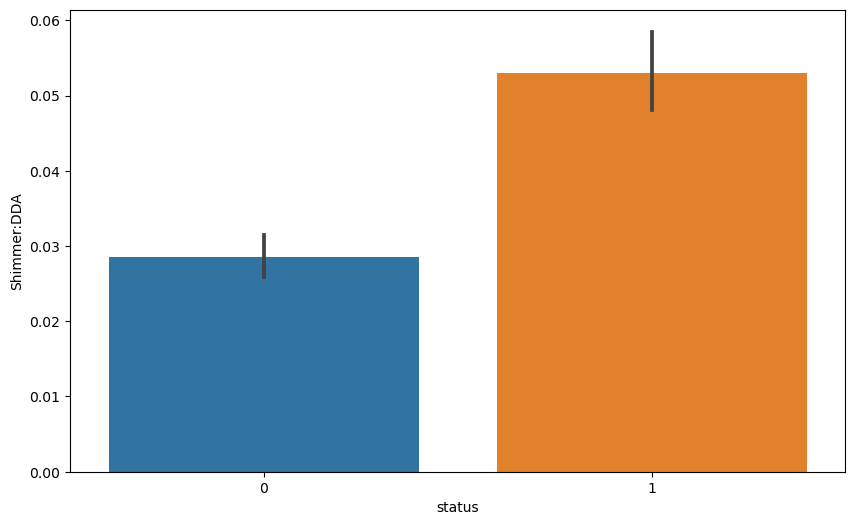

In [13]:
#to check the relation between independent and dependent variable take any x variable along with y
plt.figure(figsize=(10,6))
sns.barplot(x="status",y="Shimmer:DDA",data=df);
plt.show()
#from the below barplot we came to the conclusion that if Shimmer:DDA is less then we can say that the person don't have the disease and if Shimmer:DDA is high we can say that the person has the disease 


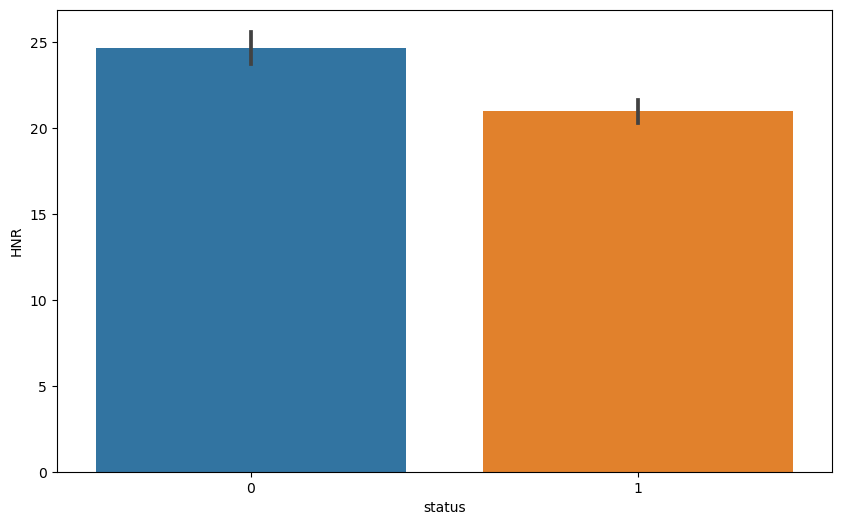

In [14]:
#another analysis of relation between independent and dependent variables is
plt.figure(figsize=(10,6))
sns.barplot(x="status",y="HNR",data=df);
plt.show()

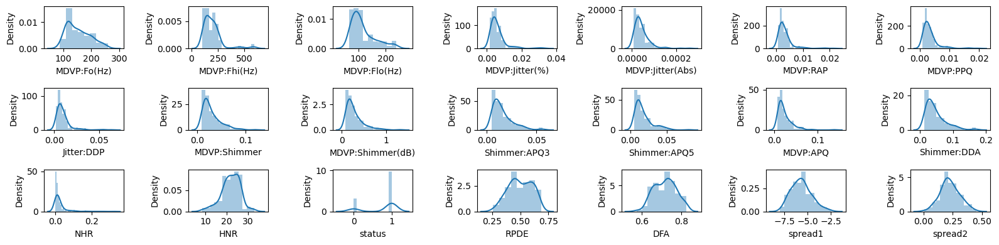

In [15]:
#creating displot to check to check the skewness and outliers present in data
import warnings
warnings.filterwarnings('ignore')
rows=3
cols=7
fig, ax=plt.subplots(nrows=rows,ncols=cols,figsize=(16,4))
col=df.columns
index=1
for i in range(rows):
    for j in range(cols):
        sns.distplot(df[col[index]],ax=ax[i][j])
        index=index+1
        
plt.tight_layout()
plt.show()


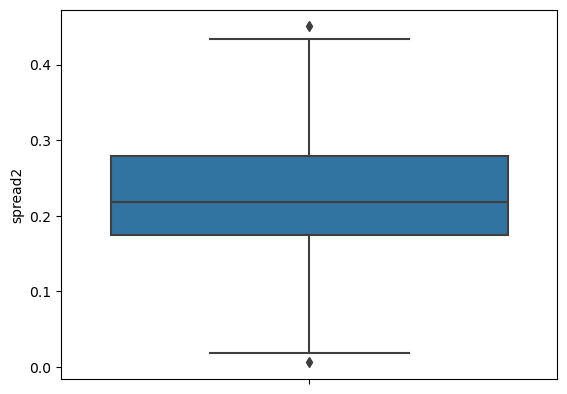

In [16]:
sns.boxplot(data=df,y='spread2');
plt.show()

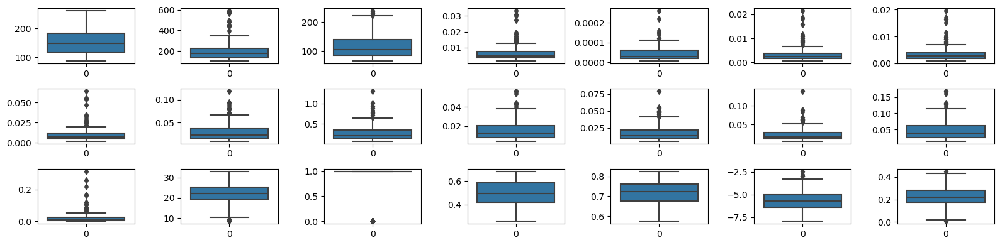

In [17]:
#boxplot to if there's outliers present in any column
import warnings
warnings.filterwarnings('ignore')
rows=3
cols=7
fig, ax=plt.subplots(nrows=rows,ncols=cols,figsize=(16,4))
col=df.columns
index=1
for i in range(rows):
    for j in range(cols):
        sns.boxplot(df[col[index]],ax=ax[i][j])
        index=index+1
        
plt.tight_layout()
plt.show()


In [18]:
#LOG TRANSFORMATION TO REMOVE THE OUTLIERS
print(df.columns)


Index(['name', 'MDVP:Fo(Hz)', 'MDVP:Fhi(Hz)', 'MDVP:Flo(Hz)', 'MDVP:Jitter(%)',
       'MDVP:Jitter(Abs)', 'MDVP:RAP', 'MDVP:PPQ', 'Jitter:DDP',
       'MDVP:Shimmer', 'MDVP:Shimmer(dB)', 'Shimmer:APQ3', 'Shimmer:APQ5',
       'MDVP:APQ', 'Shimmer:DDA', 'NHR', 'HNR', 'status', 'RPDE', 'DFA',
       'spread1', 'spread2', 'D2', 'PPE'],
      dtype='object')


In [19]:
#column where we want to perform log transformation
columns_to_transform = [
    'MDVP:Fo(Hz)', 'MDVP:Fhi(Hz)', 'MDVP:Flo(Hz)', 'MDVP:Jitter(%)',
    'MDVP:Jitter(Abs)', 'MDVP:RAP', 'MDVP:PPQ', 'Jitter:DDP',
    'MDVP:Shimmer', 'MDVP:Shimmer(dB)', 'Shimmer:APQ3', 'Shimmer:APQ5',
    'MDVP:APQ', 'Shimmer:DDA', 'NHR'
]

In [20]:
#log transfromation
for column in columns_to_transform:
    df[column] = np.log(df[column])
print(df)

               name  MDVP:Fo(Hz)  MDVP:Fhi(Hz)  MDVP:Flo(Hz)  MDVP:Jitter(%)  \
0    phon_R01_S01_1     4.787425      5.058168      4.317448       -4.848516   
1    phon_R01_S01_2     4.807294      5.001595      4.734609       -4.637693   
2    phon_R01_S01_3     4.759452      4.876044      4.714518       -4.556380   
3    phon_R01_S01_4     4.759401      4.926318      4.712822       -4.608175   
4    phon_R01_S01_5     4.753711      4.954284      4.706417       -4.355190   
..              ...          ...           ...           ...             ...   
190  phon_R01_S50_2     5.160135      5.442322      4.546068       -5.383875   
191  phon_R01_S50_3     5.344800      5.533457      4.494105       -5.177871   
192  phon_R01_S50_4     5.163002      5.480660      4.307936       -4.297685   
193  phon_R01_S50_5     5.292118      5.983838      4.316207       -4.906275   
194  phon_R01_S50_6     5.367326      5.561746      4.356363       -5.172566   

     MDVP:Jitter(Abs)  MDVP:RAP  MDVP:P

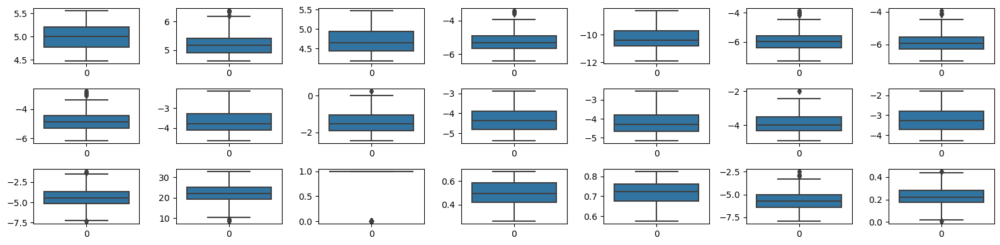

In [21]:
#skewness after log transformation
import warnings
warnings.filterwarnings('ignore')
rows=3
cols=7
fig, ax=plt.subplots(nrows=rows,ncols=cols,figsize=(16,4))
col=df.columns
index=1
for i in range(rows):
    for j in range(cols):
        sns.boxplot(df[col[index]],ax=ax[i][j])
        index=index+1
        
plt.tight_layout()
plt.show()

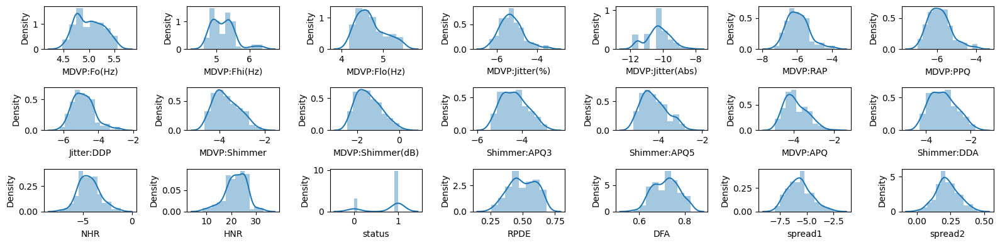

In [22]:
#box plot after tranformation
import warnings
warnings.filterwarnings('ignore')
rows=3
cols=7
fig, ax=plt.subplots(nrows=rows,ncols=cols,figsize=(16,4))
col=df.columns
index=1
for i in range(rows):
    for j in range(cols):
        sns.distplot(df[col[index]],ax=ax[i][j])
        index=index+1
        
plt.tight_layout()
plt.show()

In [23]:
#correlation matrix
dfc=df.iloc[:,1:]
corr = dfc.corr()
display (corr)


,MDVP:Fo(Hz),MDVP:Fhi(Hz),MDVP:Flo(Hz),MDVP:Jitter(%),MDVP:Jitter(Abs),MDVP:RAP,MDVP:PPQ,Jitter:DDP,MDVP:Shimmer,MDVP:Shimmer(dB),...,Shimmer:DDA,NHR,HNR,status,RPDE,DFA,spread1,spread2,D2,PPE
MDVP:Fo(Hz),1.000000,0.614204,0.484852,-0.242097,-0.582086,-0.167412,-0.244719,-0.167574,-0.144907,-0.134764,...,-0.126393,-0.121253,0.045828,-0.337455,-0.392195,-0.443096,-0.397349,-0.232890,0.206901,-0.359065
MDVP:Fhi(Hz),0.614204,1.000000,0.114072,-0.008974,-0.234746,0.003457,-0.019688,0.003329,-0.063263,-0.025032,...,-0.077259,0.099864,-0.029015,-0.202501,-0.176631,-0.415780,-0.145343,-0.039799,0.227130,-0.128807
MDVP:Flo(Hz),0.484852,0.114072,1.000000,-0.340846,-0.490560,-0.278755,-0.286040,-0.278806,-0.238159,-0.246437,...,-0.212732,-0.400602,0.211984,-0.345347,-0.389906,0.014634,-0.365967,-0.205511,-0.100655,-0.313599
MDVP:Jitter(%),-0.242097,-0.008974,-0.340846,1.000000,0.917185,0.974633,0.974122,0.974683,0.755118,0.786299,...,0.732505,0.843225,-0.786056,0.386407,0.472701,0.190433,0.789686,0.462593,0.456797,0.795246
MDVP:Jitter(Abs),-0.582086,-0.234746,-0.490560,0.917185,1.000000,0.864503,0.897411,0.864598,0.674491,0.698159,...,0.645650,0.745575,-0.662882,0.472408,0.547647,0.319003,0.813956,0.492663,0.307872,0.799934
MDVP:RAP,-0.167412,0.003457,-0.278755,0.974633,0.864503,1.000000,0.967840,0.999998,0.757591,0.784384,...,0.742384,0.835927,-0.793700,0.373591,0.437253,0.169989,0.737710,0.369152,0.452272,0.742261
MDVP:PPQ,-0.244719,-0.019688,-0.286040,0.974122,0.897411,0.967840,1.000000,0.967856,0.784733,0.812522,...,0.759532,0.808364,-0.799618,0.392505,0.459046,0.270677,0.806669,0.451291,0.426558,0.833714
Jitter:DDP,-0.167574,0.003329,-0.278806,0.974683,0.864598,0.999998,0.967856,1.000000,0.757526,0.784324,...,0.742300,0.835932,-0.793723,0.373758,0.437104,0.169951,0.737870,0.369131,0.452238,0.742410
MDVP:Shimmer,-0.144907,-0.063263,-0.238159,0.755118,0.674491,0.757591,0.784733,0.757526,1.000000,0.992705,...,0.989313,0.775527,-0.867759,0.412005,0.519752,0.183952,0.680086,0.449342,0.497946,0.700309
MDVP:Shimmer(dB),-0.134764,-0.025032,-0.246437,0.786299,0.698159,0.784384,0.812522,0.784324,0.992705,1.000000,...,0.975825,0.800812,-0.872596,0.411607,0.498244,0.180138,0.688042,0.459914,0.512414,0.709530


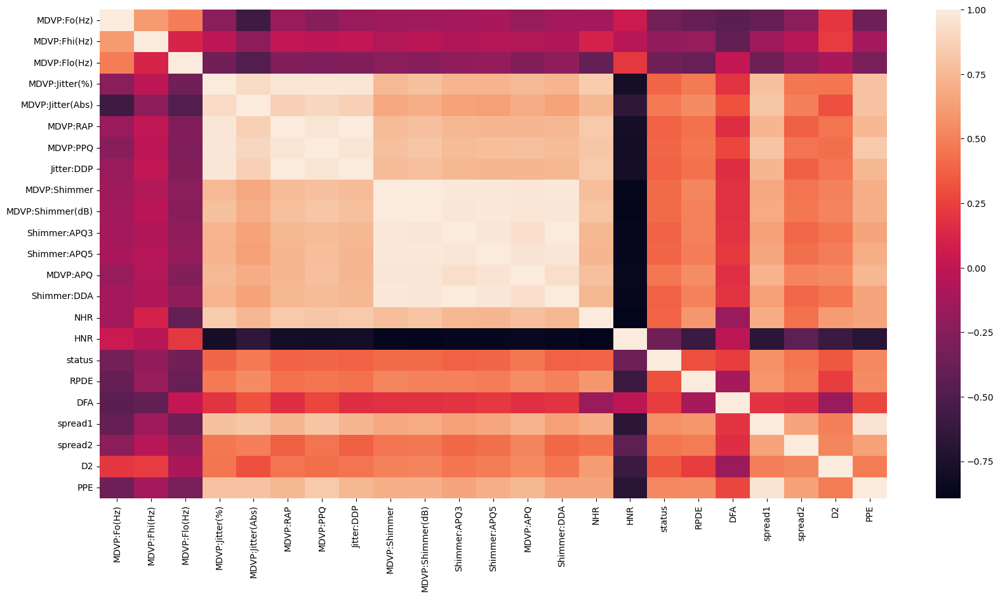

In [24]:
#create a heatmap with default parameters
from matplotlib.pylab import rcParams
rcParams['figure.figsize']=20,10
sns.heatmap(corr)
plt.show()


In [25]:
print(df)

               name  MDVP:Fo(Hz)  MDVP:Fhi(Hz)  MDVP:Flo(Hz)  MDVP:Jitter(%)  \
0    phon_R01_S01_1     4.787425      5.058168      4.317448       -4.848516   
1    phon_R01_S01_2     4.807294      5.001595      4.734609       -4.637693   
2    phon_R01_S01_3     4.759452      4.876044      4.714518       -4.556380   
3    phon_R01_S01_4     4.759401      4.926318      4.712822       -4.608175   
4    phon_R01_S01_5     4.753711      4.954284      4.706417       -4.355190   
..              ...          ...           ...           ...             ...   
190  phon_R01_S50_2     5.160135      5.442322      4.546068       -5.383875   
191  phon_R01_S50_3     5.344800      5.533457      4.494105       -5.177871   
192  phon_R01_S50_4     5.163002      5.480660      4.307936       -4.297685   
193  phon_R01_S50_5     5.292118      5.983838      4.316207       -4.906275   
194  phon_R01_S50_6     5.367326      5.561746      4.356363       -5.172566   

     MDVP:Jitter(Abs)  MDVP:RAP  MDVP:P

In [26]:
#drop the name column for Ml algo and create X and Y
df.drop(['name'],axis=1,inplace=True)
display(df)


,MDVP:Fo(Hz),MDVP:Fhi(Hz),MDVP:Flo(Hz),MDVP:Jitter(%),MDVP:Jitter(Abs),MDVP:RAP,MDVP:PPQ,Jitter:DDP,MDVP:Shimmer,MDVP:Shimmer(dB),...,Shimmer:DDA,NHR,HNR,status,RPDE,DFA,spread1,spread2,D2,PPE
0,4.787425,5.058168,4.317448,-4.848516,-9.567015,-5.599422,-5.195761,-4.501711,-3.129492,-0.853316,...,-2.726469,-3.811725,21.033,1,0.414783,0.815285,-4.813031,0.266482,2.301442,0.284654
1,4.807294,5.001595,4.734609,-4.637693,-9.433484,-5.370888,-4.967576,-4.272993,-2.791323,-0.468405,...,-2.364141,-3.948168,19.085,1,0.458359,0.819521,-4.075192,0.335590,2.486855,0.368674
2,4.759452,4.876044,4.714518,-4.556380,-9.315701,-5.213976,-4.852350,-4.114751,-2.950185,-0.729811,...,-2.492536,-4.335907,20.651,1,0.429895,0.825288,-4.443179,0.311173,2.342259,0.332634
3,4.759401,4.926318,4.712822,-4.608175,-9.315701,-5.294325,-4.964706,-4.196377,-2.901878,-0.659712,...,-2.433719,-4.302846,20.644,1,0.434969,0.819235,-4.117501,0.334147,2.405554,0.368975
4,4.753711,4.954284,4.706417,-4.355190,-9.115030,-5.028290,-4.701681,-3.929169,-2.744974,-0.537854,...,-2.256656,-4.035887,19.649,1,0.417356,0.823484,-3.747787,0.234513,2.332180,0.410335
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
190,5.160135,5.442322,4.546068,-5.383875,-10.414313,-5.940771,-5.956097,-4.840893,-3.197359,-0.903868,...,-2.658118,-3.588491,19.517,0,0.448439,0.657899,-6.538586,0.121952,2.657476,0.133050
191,5.344800,5.533457,4.494105,-5.177871,-10.414313,-5.710807,-5.836172,-4.611188,-3.593206,-1.335601,...,-3.034057,-4.011843,19.147,0,0.431674,0.683244,-6.195325,0.129303,2.784312,0.168895
192,5.163002,5.480660,4.307936,-4.297685,-9.433484,-5.076775,-5.177871,-3.977629,-3.768789,-1.362578,...,-3.269117,-2.233526,17.883,0,0.407567,0.655683,-6.787197,0.158453,2.679772,0.131728
193,5.292118,5.983838,4.316207,-4.906275,-10.126631,-5.599422,-5.546779,-4.501711,-3.774002,-1.422958,...,-3.271749,-2.627900,19.020,0,0.451221,0.643956,-6.744577,0.207454,2.138608,0.123306


In [27]:
#create X
X = df.drop(labels=['status'],axis=1)
display(X)

,MDVP:Fo(Hz),MDVP:Fhi(Hz),MDVP:Flo(Hz),MDVP:Jitter(%),MDVP:Jitter(Abs),MDVP:RAP,MDVP:PPQ,Jitter:DDP,MDVP:Shimmer,MDVP:Shimmer(dB),...,MDVP:APQ,Shimmer:DDA,NHR,HNR,RPDE,DFA,spread1,spread2,D2,PPE
0,4.787425,5.058168,4.317448,-4.848516,-9.567015,-5.599422,-5.195761,-4.501711,-3.129492,-0.853316,...,-3.516272,-2.726469,-3.811725,21.033,0.414783,0.815285,-4.813031,0.266482,2.301442,0.284654
1,4.807294,5.001595,4.734609,-4.637693,-9.433484,-5.370888,-4.967576,-4.272993,-2.791323,-0.468405,...,-3.130865,-2.364141,-3.948168,19.085,0.458359,0.819521,-4.075192,0.335590,2.486855,0.368674
2,4.759452,4.876044,4.714518,-4.556380,-9.315701,-5.213976,-4.852350,-4.114751,-2.950185,-0.729811,...,-3.327018,-2.492536,-4.335907,20.651,0.429895,0.825288,-4.443179,0.311173,2.342259,0.332634
3,4.759401,4.926318,4.712822,-4.608175,-9.315701,-5.294325,-4.964706,-4.196377,-2.901878,-0.659712,...,-3.277565,-2.433719,-4.302846,20.644,0.434969,0.819235,-4.117501,0.334147,2.405554,0.368975
4,4.753711,4.954284,4.706417,-4.355190,-9.115030,-5.028290,-4.701681,-3.929169,-2.744974,-0.537854,...,-3.108901,-2.256656,-4.035887,19.649,0.417356,0.823484,-3.747787,0.234513,2.332180,0.410335
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
190,5.160135,5.442322,4.546068,-5.383875,-10.414313,-5.940771,-5.956097,-4.840893,-3.197359,-0.903868,...,-3.595389,-2.658118,-3.588491,19.517,0.448439,0.657899,-6.538586,0.121952,2.657476,0.133050
191,5.344800,5.533457,4.494105,-5.177871,-10.414313,-5.710807,-5.836172,-4.611188,-3.593206,-1.335601,...,-3.974430,-3.034057,-4.011843,19.147,0.431674,0.683244,-6.195325,0.129303,2.784312,0.168895
192,5.163002,5.480660,4.307936,-4.297685,-9.433484,-5.076775,-5.177871,-3.977629,-3.768789,-1.362578,...,-4.094145,-3.269117,-2.233526,17.883,0.407567,0.655683,-6.787197,0.158453,2.679772,0.131728
193,5.292118,5.983838,4.316207,-4.906275,-10.126631,-5.599422,-5.546779,-4.501711,-3.774002,-1.422958,...,-4.142695,-3.271749,-2.627900,19.020,0.451221,0.643956,-6.744577,0.207454,2.138608,0.123306


In [28]:
#create Y
Y=df['status']
display(Y)

0      1
1      1
2      1
3      1
4      1
      ..
190    0
191    0
192    0
193    0
194    0
Name: status, Length: 195, dtype: int64

In [29]:
#train test split
X_train,X_test,Y_train,Y_test=train_test_split(X,Y,test_size=0.2,random_state=40)
print (X.shape,Y.shape)
print(X_train.shape,X_test.shape,Y_train.shape,Y_test.shape)


(195, 22) (195,)
(156, 22) (39, 22) (156,) (39,)


In [30]:
#Logistic Regression
log_reg = LogisticRegression().fit(X_train, Y_train)
#predict on train 
train_preds = log_reg.predict(X_train)
#accuracy on train
print("Model accuracy on train is: ", accuracy_score(Y_train, train_preds))

#predict on test
test_preds = log_reg.predict(X_test)
#accuracy on test
print("Model accuracy on test is: ", accuracy_score(Y_test, test_preds))
print('-'*65)

#Confusion matrix
print("confusion_matrix train is:\n ", confusion_matrix(Y_train, train_preds))
print("confusion_matrix test is:\n ", confusion_matrix(Y_test, test_preds))
print('-'*65)


#classifictaion report
print('\nClassification report on train is\n\n',classification_report(Y_train,train_preds))
print('\nClassification report on test is\n\n',classification_report(Y_test,test_preds))
print('-'*65)

#Wrong Predictions made
print((Y_test !=test_preds).sum(),'/',((Y_test == test_preds).sum()+(Y_test != test_preds).sum()))

#Kappa Score
print('KappaScore is: ', metrics.cohen_kappa_score(Y_test,test_preds))
print('-'*65)


#Display the test and Predicted Values 
ddf_test=pd.DataFrame(data=[test_preds,Y_test])
display (ddf_test)

#Transpose and display
display (ddf_test.T)  






Model accuracy on train is:  0.8910256410256411
Model accuracy on test is:  0.8461538461538461
-----------------------------------------------------------------
confusion_matrix train is:
  [[ 28  12]
 [  5 111]]
confusion_matrix test is:
  [[ 5  3]
 [ 3 28]]
-----------------------------------------------------------------

Classification report on train is

               precision    recall  f1-score   support

           0       0.85      0.70      0.77        40
           1       0.90      0.96      0.93       116

    accuracy                           0.89       156
   macro avg       0.88      0.83      0.85       156
weighted avg       0.89      0.89      0.89       156


Classification report on test is

               precision    recall  f1-score   support

           0       0.62      0.62      0.62         8
           1       0.90      0.90      0.90        31

    accuracy                           0.85        39
   macro avg       0.76      0.76      0.76        39
we

,0,1,2,3,4,5,6,7,8,9,...,29,30,31,32,33,34,35,36,37,38
0,1,1,1,0,1,1,1,1,1,0,...,1,0,0,0,1,1,1,1,0,1
1,1,1,1,0,1,0,1,1,1,0,...,1,0,0,0,1,1,1,1,1,1


,0,1
0,1,1
1,1,1
2,1,1
3,0,0
4,1,1
5,1,0
6,1,1
7,1,1
8,1,1
9,0,0


In [31]:
#RandomForestClassifier
RF=RandomForestClassifier().fit(X_train,Y_train)
#predcition on train
train_preds2=RF.predict(X_train)
#accuracy for train
print("Model accuracy for train is:",accuracy_score(Y_train,train_preds2))


#predictiion of test 
test_preds2=RF.predict(X_test)
#accuracy for test
print("Model accuracy for test is:",accuracy_score(Y_test,test_preds2))
print('-'*65)


#confusion matrix
print("The confusion matrix of train is\n",confusion_matrix(Y_train,train_preds2))
print("The confusion matrix of test is\n",confusion_matrix(Y_test,test_preds2))
print('-'*65)


#classification report
print("\nClassification report of train is\n\n",classification_report(Y_train,train_preds2))
print("\nClassification report of test is\n\n",classification_report(Y_test,test_preds2))
print('-'*65)

#Wrong Predictions made
print((Y_test !=test_preds2).sum(),'/',((Y_test == test_preds2).sum()+(Y_test != test_preds2).sum()))


#Kappa Score
print('KappaScore is: ', metrics.cohen_kappa_score(Y_test,test_preds2))

#Display the test and Predicted Values 
ddf=pd.DataFrame(data=[test_preds2,Y_test])
display (ddf)


#Transpose and display
display (ddf.T)  


Model accuracy for train is: 1.0
Model accuracy for test is: 0.8717948717948718
-----------------------------------------------------------------
The confusion matrix of train is
 [[ 40   0]
 [  0 116]]
The confusion matrix of test is
 [[ 5  3]
 [ 2 29]]
-----------------------------------------------------------------

Classification report of train is

               precision    recall  f1-score   support

           0       1.00      1.00      1.00        40
           1       1.00      1.00      1.00       116

    accuracy                           1.00       156
   macro avg       1.00      1.00      1.00       156
weighted avg       1.00      1.00      1.00       156


Classification report of test is

               precision    recall  f1-score   support

           0       0.71      0.62      0.67         8
           1       0.91      0.94      0.92        31

    accuracy                           0.87        39
   macro avg       0.81      0.78      0.79        39
weighte

,0,1,2,3,4,5,6,7,8,9,...,29,30,31,32,33,34,35,36,37,38
0,1,1,1,0,1,1,1,1,1,1,...,1,0,0,0,0,1,1,1,1,1
1,1,1,1,0,1,0,1,1,1,0,...,1,0,0,0,1,1,1,1,1,1


,0,1
0,1,1
1,1,1
2,1,1
3,0,0
4,1,1
5,1,0
6,1,1
7,1,1
8,1,1
9,1,0


In [32]:
#DecisionTreeClassifier
from sklearn.tree import DecisionTreeClassifier
DT=DecisionTreeClassifier().fit(X_train,Y_train)
#prediction on train 
train_preds3=DT.predict(X_train)
#accuracy on train
print("The accuracy score for train model is:",accuracy_score(Y_train,train_preds3))


#predictiion of test 
test_preds3=DT.predict(X_test)
#accuracy for test
print("Model accuracy for test is:",accuracy_score(Y_test,test_preds3))
print('-'*65)


#Confusion matrix
print("confusion_matrix train is:\n ", confusion_matrix(Y_train, train_preds3))
print("confusion_matrix test is: \n", confusion_matrix(Y_test, test_preds3))
print('-'*65)


#classificationReport
print('\nClassification Report Train is\n\n',classification_report (Y_train, train_preds3))
print('\nClassification Report Test is\n\n',classification_report (Y_test, test_preds3))
print('-'*65)

#wrong predictions made
print((Y_test != test_preds3).sum(),'/',(Y_test == test_preds3).sum()+ (Y_test != test_preds3).sum())

#Kappa score
print('Kappa score is:',metrics.cohen_kappa_score(Y_test,test_preds3))
print('-'*65)

#Display the test and Predicted Values 
ddf=pd.DataFrame(data=[test_preds3,Y_test])
display (ddf)


#Transpose and display
display (ddf.T)  





The accuracy score for train model is: 1.0
Model accuracy for test is: 0.8461538461538461
-----------------------------------------------------------------
confusion_matrix train is:
  [[ 40   0]
 [  0 116]]
confusion_matrix test is: 
 [[ 5  3]
 [ 3 28]]
-----------------------------------------------------------------

Classification Report Train is

               precision    recall  f1-score   support

           0       1.00      1.00      1.00        40
           1       1.00      1.00      1.00       116

    accuracy                           1.00       156
   macro avg       1.00      1.00      1.00       156
weighted avg       1.00      1.00      1.00       156


Classification Report Test is

               precision    recall  f1-score   support

           0       0.62      0.62      0.62         8
           1       0.90      0.90      0.90        31

    accuracy                           0.85        39
   macro avg       0.76      0.76      0.76        39
weighted avg 

,0,1,2,3,4,5,6,7,8,9,...,29,30,31,32,33,34,35,36,37,38
0,1,1,1,0,1,1,1,1,1,1,...,1,0,0,0,0,1,1,1,1,1
1,1,1,1,0,1,0,1,1,1,0,...,1,0,0,0,1,1,1,1,1,1


,0,1
0,1,1
1,1,1
2,1,1
3,0,0
4,1,1
5,1,0
6,1,1
7,1,1
8,1,1
9,1,0


In [33]:
#Naive Byce theorem
from sklearn.naive_bayes import GaussianNB
NB=GaussianNB().fit(X_train,Y_train)
#predict on train 
train_preds4 = NB.predict(X_train)
#accuracy on train
print("Model accuracy on train is: ", accuracy_score(Y_train, train_preds4))
print('-'*65)


#predict on test
test_preds4 = NB.predict(X_test)
#accuracy on test
print("Model accuracy on test is: ", accuracy_score(Y_test, test_preds4))
print('-'*65)


#Confusion matrix
print("confusion_matrix train is: \n", confusion_matrix(Y_train, train_preds4))
print("confusion_matrix test is:\n ", confusion_matrix(Y_test, test_preds4))
print('Wrong predictions out of total')
print('-'*65)

#classification Report
print('\nClassification Report Train is\n\n',classification_report (Y_train, train_preds4))
print('\nClassification Report Test is\n\n,',classification_report (Y_test, test_preds4))
print('-'*65)

#wrong predictions made
print((Y_test != test_preds4).sum(),'/',(Y_test == test_preds4).sum()+ (Y_test != test_preds4).sum())

#Kappa score
print('Kappa score is:',metrics.cohen_kappa_score(Y_test,test_preds4))
print('-'*65)

#Display the test and Predicted Values 
ddf=pd.DataFrame(data=[test_preds4,Y_test])
display (ddf)


#Transpose and display
display (ddf.T)  



Model accuracy on train is:  0.7307692307692307
-----------------------------------------------------------------
Model accuracy on test is:  0.7692307692307693
-----------------------------------------------------------------
confusion_matrix train is: 
 [[33  7]
 [35 81]]
confusion_matrix test is:
  [[ 8  0]
 [ 9 22]]
Wrong predictions out of total
-----------------------------------------------------------------

Classification Report Train is

               precision    recall  f1-score   support

           0       0.49      0.82      0.61        40
           1       0.92      0.70      0.79       116

    accuracy                           0.73       156
   macro avg       0.70      0.76      0.70       156
weighted avg       0.81      0.73      0.75       156


Classification Report Test is

,               precision    recall  f1-score   support

           0       0.47      1.00      0.64         8
           1       1.00      0.71      0.83        31

    accuracy          

,0,1,2,3,4,5,6,7,8,9,...,29,30,31,32,33,34,35,36,37,38
0,1,1,0,0,0,0,1,1,1,0,...,0,0,0,0,1,1,1,1,0,1
1,1,1,1,0,1,0,1,1,1,0,...,1,0,0,0,1,1,1,1,1,1


,0,1
0,1,1
1,1,1
2,0,1
3,0,0
4,0,1
5,0,0
6,1,1
7,1,1
8,1,1
9,0,0


In [34]:
#K Neighbours Classifier 

from sklearn.neighbors import KNeighborsClassifier 
# Using the parameter weights='distance'  to fix the error 'Flags' object has no attribute 'c_contiguous'
KNN = KNeighborsClassifier(weights='distance').fit(X_train,Y_train)
#predict on train 
train_preds5 = KNN.predict(X_train)
#accuracy on train
print("Model accuracy on train is: ", accuracy_score(Y_train, train_preds5))

#predict on test
test_preds5 = KNN.predict(X_test)
#accuracy on test
print("Model accuracy on test is: ", accuracy_score(Y_test, test_preds5))
print('-'*65)
#Confusion matrix
print("confusion_matrix train is:\n ", confusion_matrix(Y_train, train_preds5))
print("confusion_matrix test is:\n ", confusion_matrix(Y_test, test_preds5))
print('Wrong predictions out of total')
print('-'*65)
print('\nClassification Report Train is ')
print(classification_report (Y_train, train_preds5))
print('\nClassification Report Test is ')
print(classification_report (Y_test, test_preds5))
print('-'*65)

# Wrong Predictions made.
print((Y_test !=test_preds5).sum(),'/',((Y_test == test_preds5).sum()+(Y_test != test_preds5).sum()))

print('-'*65)
# Kappa Score
print('KappaScore is: ', metrics.cohen_kappa_score(Y_test,test_preds5))

#Display the test and Predicted Values 
ddf=pd.DataFrame(data=[test_preds5,Y_test])
display (ddf)


#Transpose and display
display (ddf.T)  




Model accuracy on train is:  1.0
Model accuracy on test is:  0.9230769230769231
-----------------------------------------------------------------
confusion_matrix train is:
  [[ 40   0]
 [  0 116]]
confusion_matrix test is:
  [[ 6  2]
 [ 1 30]]
Wrong predictions out of total
-----------------------------------------------------------------

Classification Report Train is 
              precision    recall  f1-score   support

           0       1.00      1.00      1.00        40
           1       1.00      1.00      1.00       116

    accuracy                           1.00       156
   macro avg       1.00      1.00      1.00       156
weighted avg       1.00      1.00      1.00       156


Classification Report Test is 
              precision    recall  f1-score   support

           0       0.86      0.75      0.80         8
           1       0.94      0.97      0.95        31

    accuracy                           0.92        39
   macro avg       0.90      0.86      0.88     

,0,1,2,3,4,5,6,7,8,9,...,29,30,31,32,33,34,35,36,37,38
0,1,1,1,0,1,1,1,1,1,1,...,1,0,0,0,1,1,1,1,1,1
1,1,1,1,0,1,0,1,1,1,0,...,1,0,0,0,1,1,1,1,1,1


,0,1
0,1,1
1,1,1
2,1,1
3,0,0
4,1,1
5,1,0
6,1,1
7,1,1
8,1,1
9,1,0


In [35]:
#Support Vector Machine(SVM)
from sklearn.svm import SVC
#fit the model on train data 
SVM = SVC(kernel='linear')
SVM.fit(X_train, Y_train)

#prediction on train
train_preds6=SVM.predict(X_train)
#accuracy on train
print("Model accuracy on train is: ", accuracy_score(Y_train, train_preds6))


#prediction on test
test_preds6=SVM.predict(X_test)
#accuracy on train
print("Model accuracy on test is: ", accuracy_score(Y_test, test_preds6))
print('-'*65)

#Confusion matrix
print("confusion_matrix train is: \n", confusion_matrix(Y_train, train_preds6))
print("confusion_matrix test is:\n ", confusion_matrix(Y_test, test_preds6))
print('-'*65)


print("recall", metrics.recall_score(Y_test, test_preds6))
print('-'*65)
print('\nClassification Report Train is\n\n',classification_report (Y_train, train_preds6))
print('\nClassification Report Test is \n\n',classification_report (Y_test, test_preds6))   
print('-'*65)


# Wrong Predictions made.
print((Y_test !=test_preds6).sum(),'/',((Y_test == test_preds6).sum()+(Y_test != test_preds6).sum()))
print('-'*65)
# Kappa Score
print('KappaScore is: ', metrics.cohen_kappa_score(Y_test,test_preds6))

#Display the test and Predicted Values 
ddf=pd.DataFrame(data=[test_preds6,Y_test])
display (ddf)


#Transpose and display
display (ddf.T)  


Model accuracy on train is:  0.9102564102564102
Model accuracy on test is:  0.8461538461538461
-----------------------------------------------------------------
confusion_matrix train is: 
 [[ 29  11]
 [  3 113]]
confusion_matrix test is:
  [[ 4  4]
 [ 2 29]]
-----------------------------------------------------------------
recall 0.9354838709677419
-----------------------------------------------------------------

Classification Report Train is

               precision    recall  f1-score   support

           0       0.91      0.72      0.81        40
           1       0.91      0.97      0.94       116

    accuracy                           0.91       156
   macro avg       0.91      0.85      0.87       156
weighted avg       0.91      0.91      0.91       156


Classification Report Test is 

               precision    recall  f1-score   support

           0       0.67      0.50      0.57         8
           1       0.88      0.94      0.91        31

    accuracy           

,0,1,2,3,4,5,6,7,8,9,...,29,30,31,32,33,34,35,36,37,38
0,1,1,1,0,1,1,1,1,1,1,...,1,0,0,0,1,1,1,1,0,1
1,1,1,1,0,1,0,1,1,1,0,...,1,0,0,0,1,1,1,1,1,1


,0,1
0,1,1
1,1,1
2,1,1
3,0,0
4,1,1
5,1,0
6,1,1
7,1,1
8,1,1
9,1,0


In [38]:
result = SVM.predict(X)
display(result)

array([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1,
       1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 0, 0, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 0, 1],
      dtype=int64)

In [37]:
import pickle 
# Saving model to disk
pickle.dump(SVM,open('n_SVM.pkl','wb'))
# Open the Pickle File 
model=pickle.load(open('n_SVM.pkl','rb'))
# Prediction 
print (model.predict (X_train))


[1 1 1 1 1 0 1 0 1 1 1 1 1 1 0 1 1 1 0 1 1 1 1 1 0 1 1 1 0 1 1 0 0 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 0 1 1 1 1 1 1 1 1 0 0 1 0 0 1 1 1
 0 0 0 1 1 1 1 1 1 1 1 0 0 1 1 1 1 1 1 1 1 0 1 1 1 1 1 0 1 1 1 0 0 1 1 1 1
 1 1 1 1 1 1 1 0 1 1 1 1 0 1 0 0 0 0 1 1 1 1 1 1 0 1 1 1 1 1 0 1 1 1 1 1 1
 1 1 1 0 1 0 1 1]
